In [ ]:
import os
import time
import kagglehub
import numpy as np
import warnings

from skimage.io import imread
import matplotlib.pyplot as plt
from utils import (
    contrast_filter,
    sharpen,
    mask_boundary,
    averaging_filter,
    closing,
    circular_kernel,
    transform_pupil_img,
    transform_pupil_imgs,
    analyse_pupil_projection,
    get_pupils,
    sobel_filter,
    mask_circle,
    get_radial_projection,
    analyse_iris_projection,
    transform_iris_imgs,
    get_irises,
    unwrap_annular_segment,
    get_irises_parts,
    save_imgs,
    image_to_iris_code,
    get_cropped_bands_rescaled,
)

os.makedirs("figures", exist_ok=True)

# Dataset

[MMU Iris Dataset](https://www.kaggle.com/datasets/naureenmohammad/mmu-iris-dataset)

In [2]:
path = kagglehub.dataset_download("naureenmohammad/mmu-iris-dataset")

In [3]:
imgs_info = []
for dir, _, files in sorted(os.walk(path)):
    idx = dir.split("MMU-Iris-Database/")[-1].split("/")[0]
    if dir.endswith("left"):
        class_name = "left"
    elif dir.endswith("right"):
        class_name = "right"
    else:
        continue

    for file in files:
        no = file.split(".")[0][-1]
        if file.endswith(".bmp"):
            imgs_info.append((dir, file, f"{idx}-{no}", class_name))

In [4]:
imgs_dt = []
for dir, file, idx, class_name in imgs_info:
    img = imread(os.path.join(dir, file))
    imgs_dt.append((img, f"{class_name}_{idx}"))

In [5]:
imgs_dt[0][0].shape

(240, 320, 3)

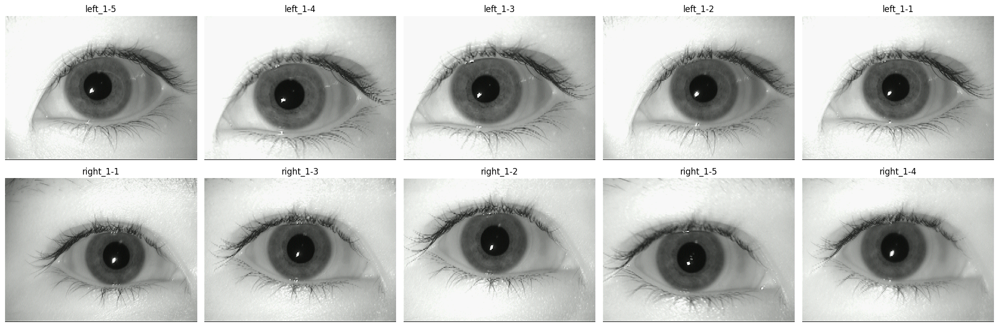

In [6]:
fig, axs = plt.subplots(2, 5, figsize=(20, 10))

for i, (img, label) in enumerate(imgs_dt[:10]):
    axs[i // 5, i % 5].imshow(img)
    axs[i // 5, i % 5].set_title(label)
    axs[i // 5, i % 5].axis("off")

plt.tight_layout()
plt.subplots_adjust(hspace=-0.5)
plt.savefig(
    os.path.join("figures", "eyes_presentation.png"),
    dpi=50,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

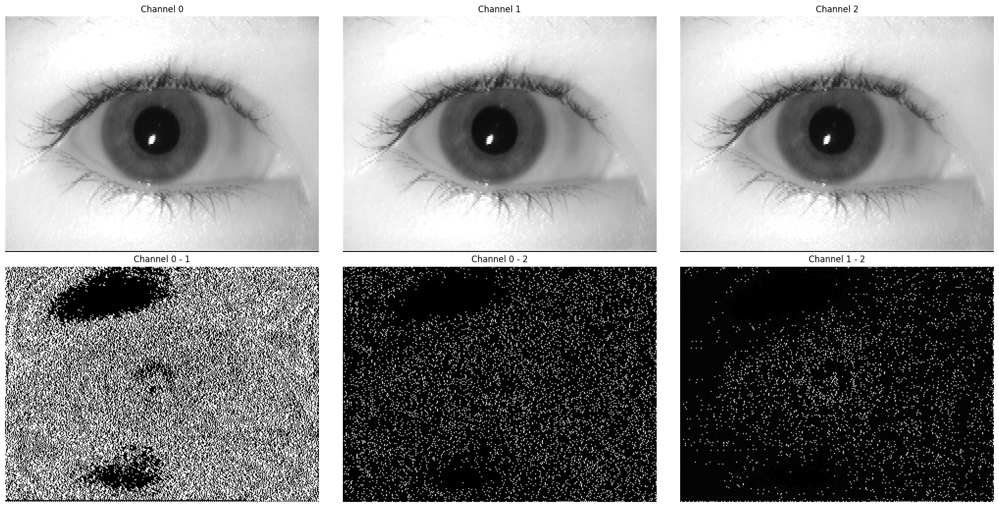

In [7]:
fig, axs = plt.subplots(2, 3, figsize=(20, 10))
axs = axs.ravel()

axs[0].imshow(img[:, :, 0], cmap="gray")
axs[0].set_title("Channel 0")
axs[0].axis("off")

axs[1].imshow(img[:, :, 1], cmap="gray")
axs[1].set_title("Channel 1")
axs[1].axis("off")

axs[2].imshow(img[:, :, 2], cmap="gray")
axs[2].set_title("Channel 2")
axs[2].axis("off")

axs[3].imshow(img[:, :, 0] - img[:, :, 1], cmap="gray")
axs[3].set_title("Channel 0 - 1")
axs[3].axis("off")

axs[4].imshow(img[:, :, 0] - img[:, :, 2], cmap="gray")
axs[4].set_title("Channel 0 - 2")
axs[4].axis("off")

axs[5].imshow(img[:, :, 1] - img[:, :, 2], cmap="gray")
axs[5].set_title("Channel 1 - 2")
axs[5].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "channels_differences.png"),
    dpi=50,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

In [8]:
imgs_original = []

for i in range(len(imgs_dt)):
    img = imgs_dt[i][0]
    imgs_original.append(img)
    imgs_dt[i] = (
        0.2989 * img[:, :, 0] + 0.5870 * img[:, :, 1] + 0.1140 * img[:, :, 2],
        imgs_dt[i][1],
    )

imgs_original = np.array(imgs_original)
imgs = np.array([img[0] for img in imgs_dt])
labels = np.array([img[1] for img in imgs_dt])

In [9]:
imgs.shape

(450, 240, 320)

# Detekcja granic źrenicy

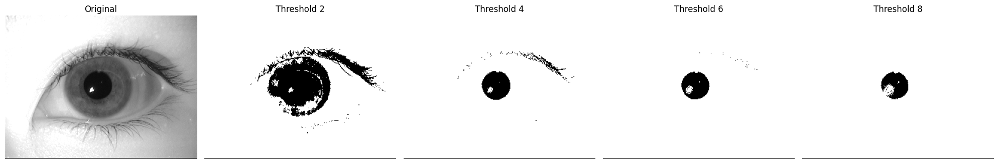

In [10]:
fig, axs = plt.subplots(1, 5, figsize=(20, 10))

img = imgs[0]

axs[0].imshow(img, cmap="gray")
axs[0].set_title("Original")
axs[0].axis("off")

p = np.mean(img)

for i, threshold in enumerate(range(2, 9, 2)):
    axs[i + 1].imshow(img < p / threshold, cmap="binary")
    axs[i + 1].set_title(f"Threshold {threshold}")
    axs[i + 1].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pupil_thresholds.png"),
    dpi=50,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

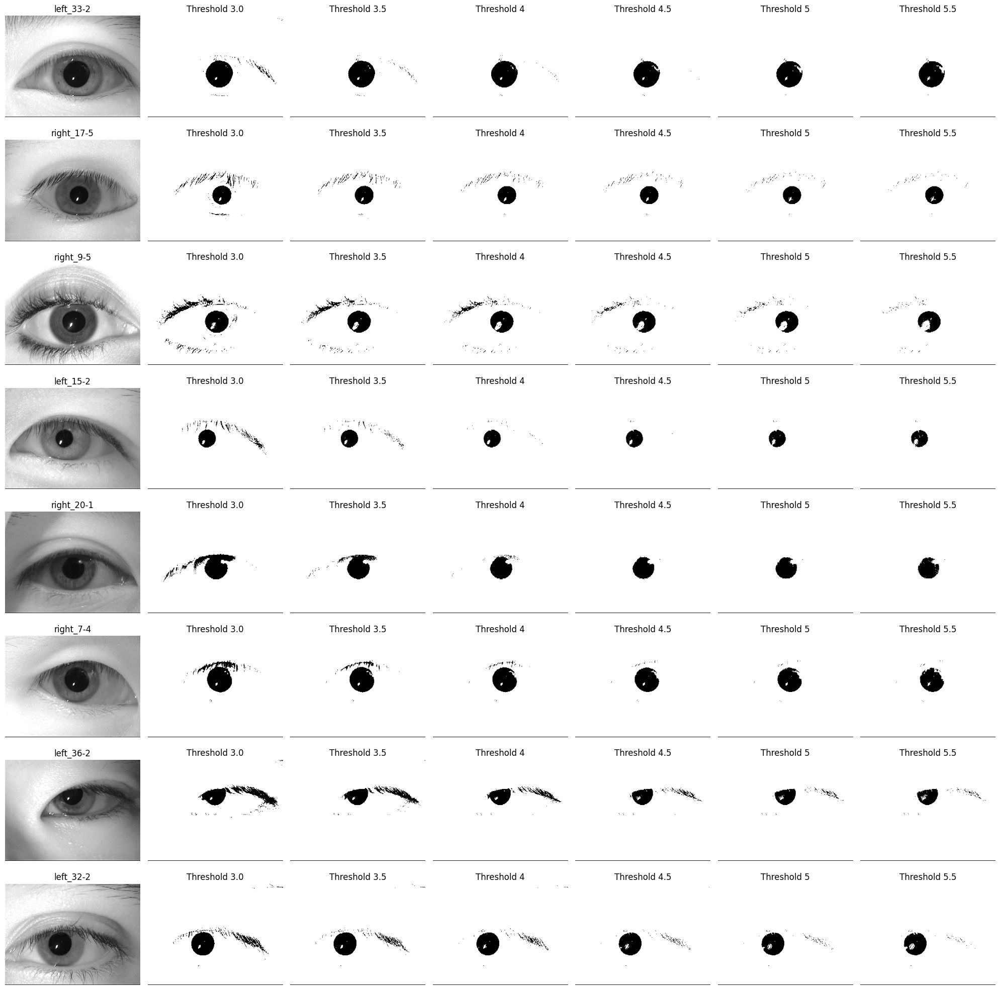

In [11]:
fig, axs = plt.subplots(8, 7, figsize=(20, 20))
axs = axs.ravel()

random_idxs = np.random.randint(0, imgs.shape[0], 8)

for j, k in enumerate(random_idxs):
    img = imgs[k, :, :]
    label = labels[k]
    idx = 7 * j

    axs[idx].imshow(img, cmap="gray")
    axs[idx].set_title(label)
    axs[idx].axis("off")

    p = np.mean(img)
    for i, threshold in enumerate([3.0, 3.5, 4, 4.5, 5, 5.5]):
        axs[idx + i + 1].imshow(img < p / threshold, cmap="binary")
        axs[idx + i + 1].set_title(f"Threshold {threshold}")
        axs[idx + i + 1].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pupil_thresholds_many.png"),
    dpi=50,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

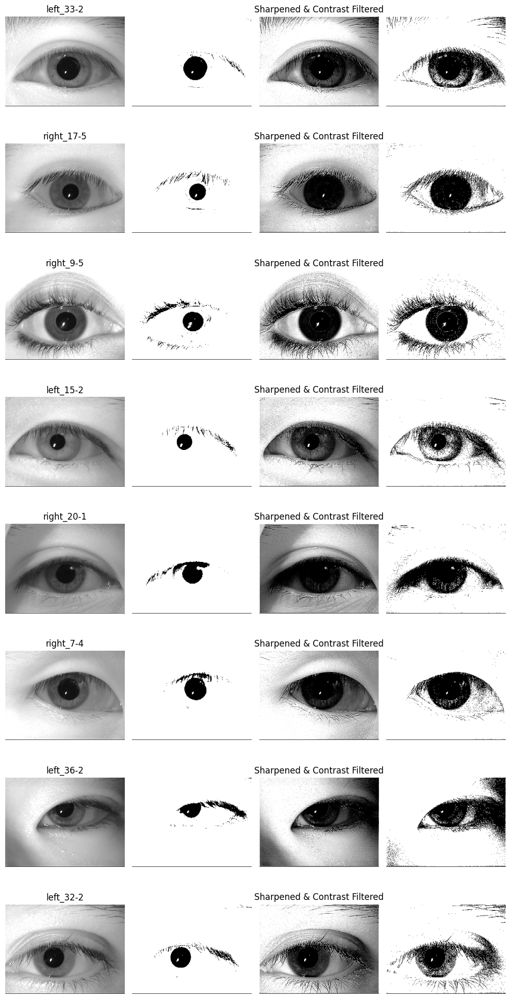

In [12]:
fig, axs = plt.subplots(8, 4, figsize=(10, 20))
axs = axs.ravel()

for j, k in enumerate(random_idxs):
    img = imgs[k, :, :]
    label = labels[k]
    idx = 4 * j

    p = np.mean(img)

    axs[idx].imshow(img, cmap="gray")
    axs[idx].set_title(label)
    axs[idx].axis("off")

    axs[idx + 1].imshow(img < p / 3.0, cmap="binary")
    axs[idx + 1].axis("off")

    transformed_img = contrast_filter(sharpen(img))
    p = np.mean(transformed_img)

    axs[idx + 2].imshow(transformed_img, cmap="gray")
    axs[idx + 2].set_title("Sharpened & Contrast Filtered")
    axs[idx + 2].axis("off")

    axs[idx + 3].imshow(transformed_img < p / 3.0, cmap="binary")
    axs[idx + 3].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "eye_filters_many.png"),
    dpi=50,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

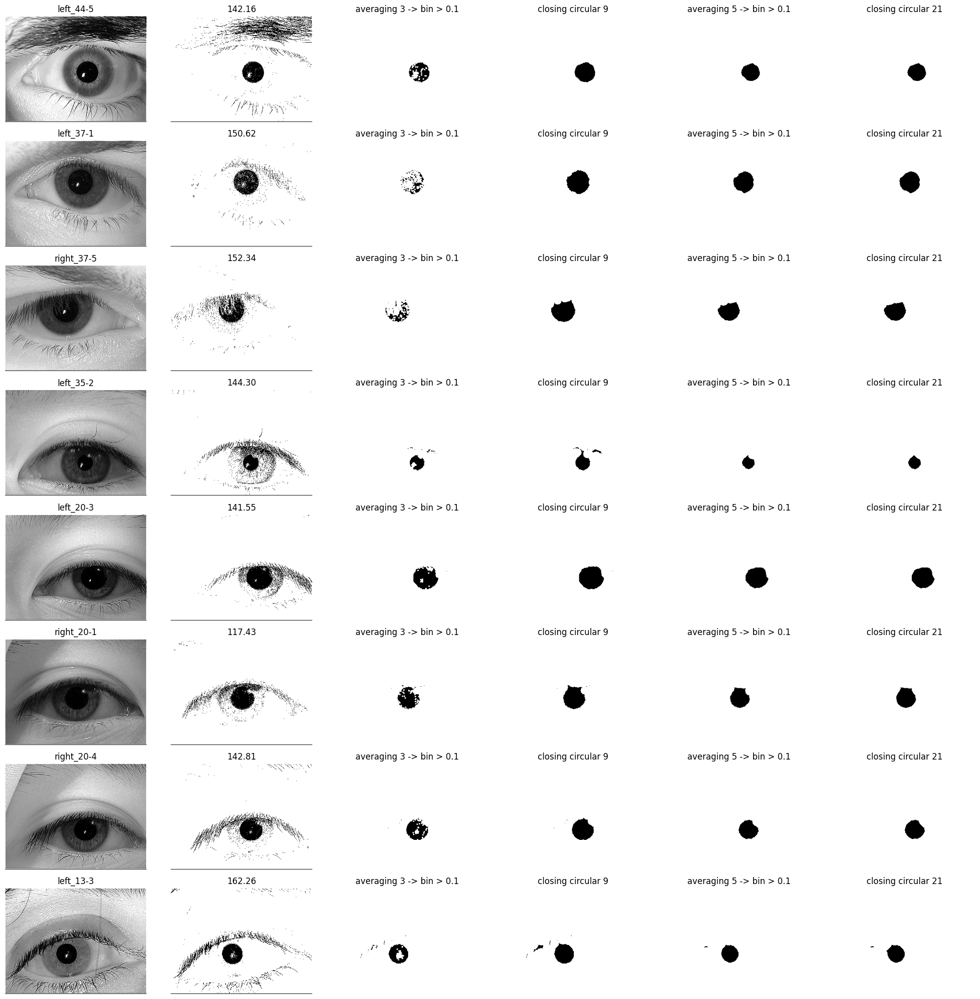

In [13]:
fig, axs = plt.subplots(8, 6, figsize=(20, 20))
axs = axs.ravel()

# for j, k in enumerate(random_idxs):
for j, k in enumerate([374, 300, 305, 281, 124, 127, 128, 44]):
    img = contrast_filter(sharpen(imgs[k, :, :]), factor=1.2)
    label = labels[k]
    idx = 6 * j
    p = np.mean(img)

    axs[idx].imshow(img, cmap="gray")
    axs[idx].set_title(label)
    axs[idx].axis("off")

    p = np.mean(img)
    img_bin = img < p / 6.0
    axs[idx + 1].imshow(img_bin, cmap="binary")
    axs[idx + 1].set_title(f"{p:.2f}")
    axs[idx + 1].axis("off")

    img_bin = mask_boundary(img_bin, 50)
    img_blur = averaging_filter(img_bin.astype(np.float32), kernel_size=3)
    img_bin = img_blur > 0.1
    axs[idx + 2].imshow(img_bin, cmap="binary")
    axs[idx + 2].set_title("averaging 3 -> bin > 0.1")
    axs[idx + 2].axis("off")

    img_closed = closing(img_bin, kernel=circular_kernel(9))
    axs[idx + 3].imshow(img_closed, cmap="binary")
    axs[idx + 3].set_title("closing circular 9")
    axs[idx + 3].axis("off")

    img_blur = averaging_filter(img_closed.astype(np.float32), kernel_size=5)
    img_bin = img_blur > 0.1
    axs[idx + 4].imshow(img_bin, cmap="binary")
    axs[idx + 4].set_title("averaging 5 -> bin > 0.1")
    axs[idx + 4].axis("off")

    img_closed = closing(img_bin, kernel=circular_kernel(21))
    axs[idx + 5].imshow(img_closed, cmap="binary")
    axs[idx + 5].set_title("closing circular 21")
    axs[idx + 5].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pulpis_detection_many.png"),
    dpi=50,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

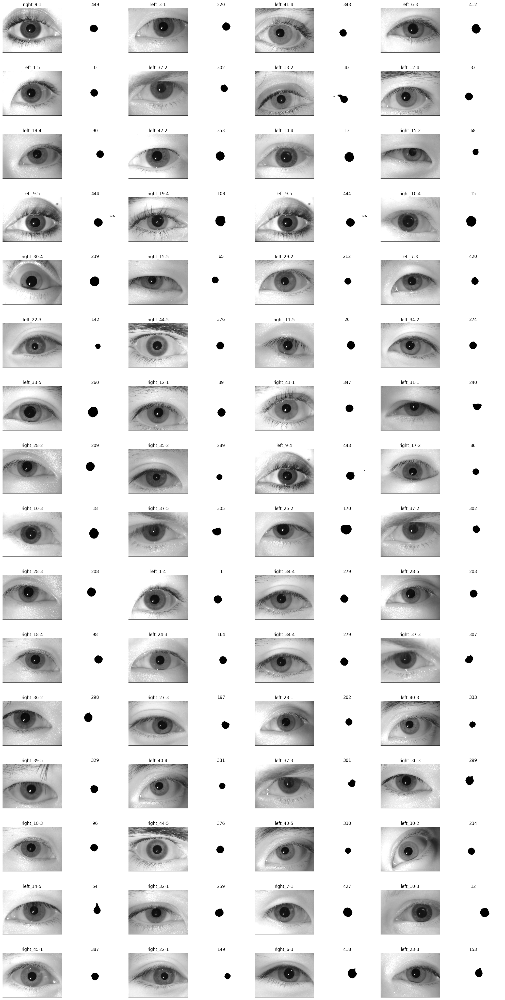

In [14]:
fig, axs = plt.subplots(16, 8, figsize=(20, 40))
axs = axs.ravel()

for j, k in enumerate(np.random.randint(0, imgs.shape[0], 64)):
    img = imgs[k, :, :]
    label = labels[k]
    idx = 2 * j

    transformed_img = transform_pupil_img(img)

    axs[idx].imshow(img, cmap="gray")
    axs[idx + 1].imshow(transformed_img, cmap="binary", alpha=0.5)
    axs[idx].set_title(label)
    axs[idx].axis("off")

    axs[idx + 1].imshow(transformed_img, cmap="binary")
    axs[idx + 1].set_title(k)
    axs[idx + 1].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pupils_detected_many.png"),
    dpi=50,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

In [15]:
pupil_imgs = transform_pupil_imgs(imgs)

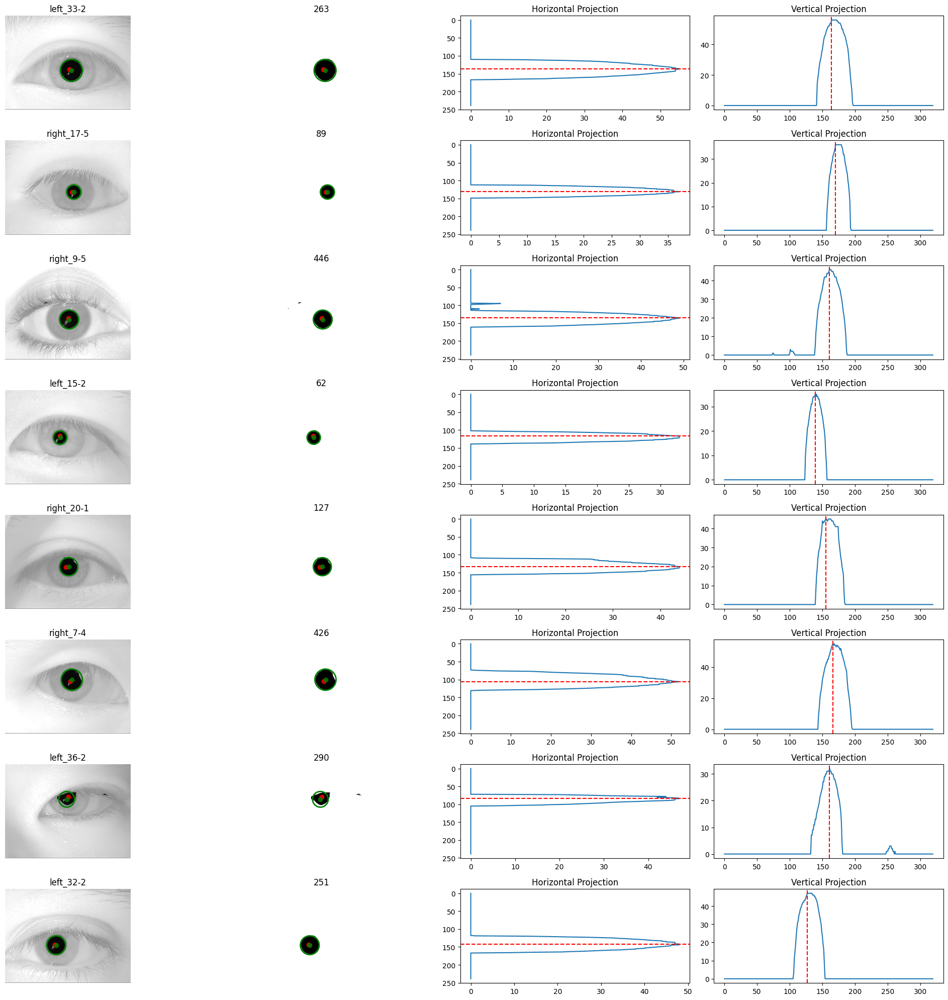

In [16]:
fig, axs = plt.subplots(8, 4, figsize=(20, 20))
axs = axs.ravel()

for j, k in enumerate(random_idxs):
    img = imgs[k, :, :]
    pupil_img = pupil_imgs[k, :, :]
    label = labels[k]
    idx = 4 * j

    axs[idx].imshow(img, cmap="gray")
    axs[idx].imshow(pupil_img, cmap="binary", alpha=0.5)
    axs[idx].set_title(label)
    axs[idx].axis("off")

    axs[idx + 1].imshow(pupil_img, cmap="binary")
    axs[idx + 1].set_title(k)
    axs[idx + 1].axis("off")

    vertical_projection = np.sum(pupil_img, axis=0)
    horizontal_projection = np.sum(pupil_img, axis=1)
    max_horizontal = np.argmax(horizontal_projection)
    max_vertical = np.argmax(vertical_projection)

    axs[idx + 2].plot(horizontal_projection, range(len(horizontal_projection)))
    axs[idx + 2].invert_yaxis()
    axs[idx + 2].axhline(max_horizontal, color="red", linestyle="--", label="Max")
    axs[idx + 2].set_title("Horizontal Projection")

    axs[idx + 3].plot(vertical_projection)
    axs[idx + 3].axvline(max_vertical, color="red", linestyle="--", label="Max")
    axs[idx + 3].set_title("Vertical Projection")

    axs[idx].plot(max_vertical, max_horizontal, "ro", alpha=0.8)
    axs[idx + 1].plot(max_vertical, max_horizontal, "ro", alpha=0.8)

    x, radius_x = analyse_pupil_projection(vertical_projection)
    y, radius_y = analyse_pupil_projection(horizontal_projection)
    iris_radius = np.ceil((radius_x + radius_y) / 2).astype(int)

    axs[idx].plot(x, y, "go", alpha=0.8)
    axs[idx + 1].plot(x, y, "go", alpha=0.8)

    circle = plt.Circle((x, y), iris_radius, color="green", fill=False, linewidth=2)
    axs[idx].add_patch(circle)

    circle = plt.Circle((x, y), iris_radius, color="green", fill=False, linewidth=2)
    axs[idx + 1].add_patch(circle)

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pupils_projections_many.png"),
    dpi=50,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

In [17]:
pupils = get_pupils(pupil_imgs)

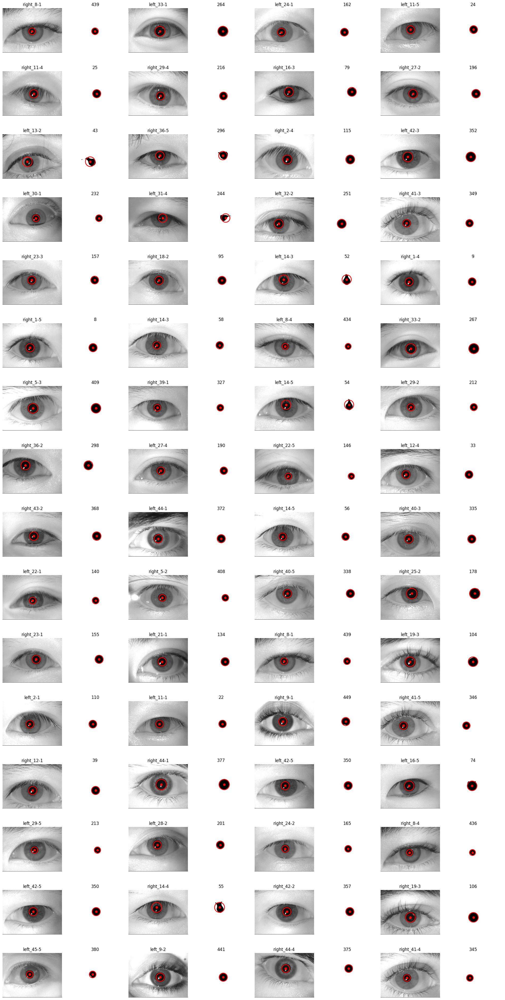

In [18]:
fig, axs = plt.subplots(16, 8, figsize=(20, 40))
axs = axs.ravel()

for j, k in enumerate(np.random.randint(0, imgs.shape[0], 64)):
    img = imgs[k, :, :]
    pupil_img = pupil_imgs[k, :, :]
    center, iris_radius = pupils[k]
    label = labels[k]
    idx = 2 * j

    circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    axs[idx].imshow(img, cmap="gray")
    axs[idx].plot(*center, "ro")
    axs[idx].add_patch(circle)
    axs[idx].set_title(label)
    axs[idx].axis("off")

    circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    axs[idx + 1].imshow(pupil_img, cmap="binary")
    axs[idx + 1].plot(*center, "ro")
    axs[idx + 1].add_patch(circle)
    axs[idx + 1].set_title(k)
    axs[idx + 1].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "pupils_detected_many.png"),
    dpi=50,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

# Detekcja granic tęczówki

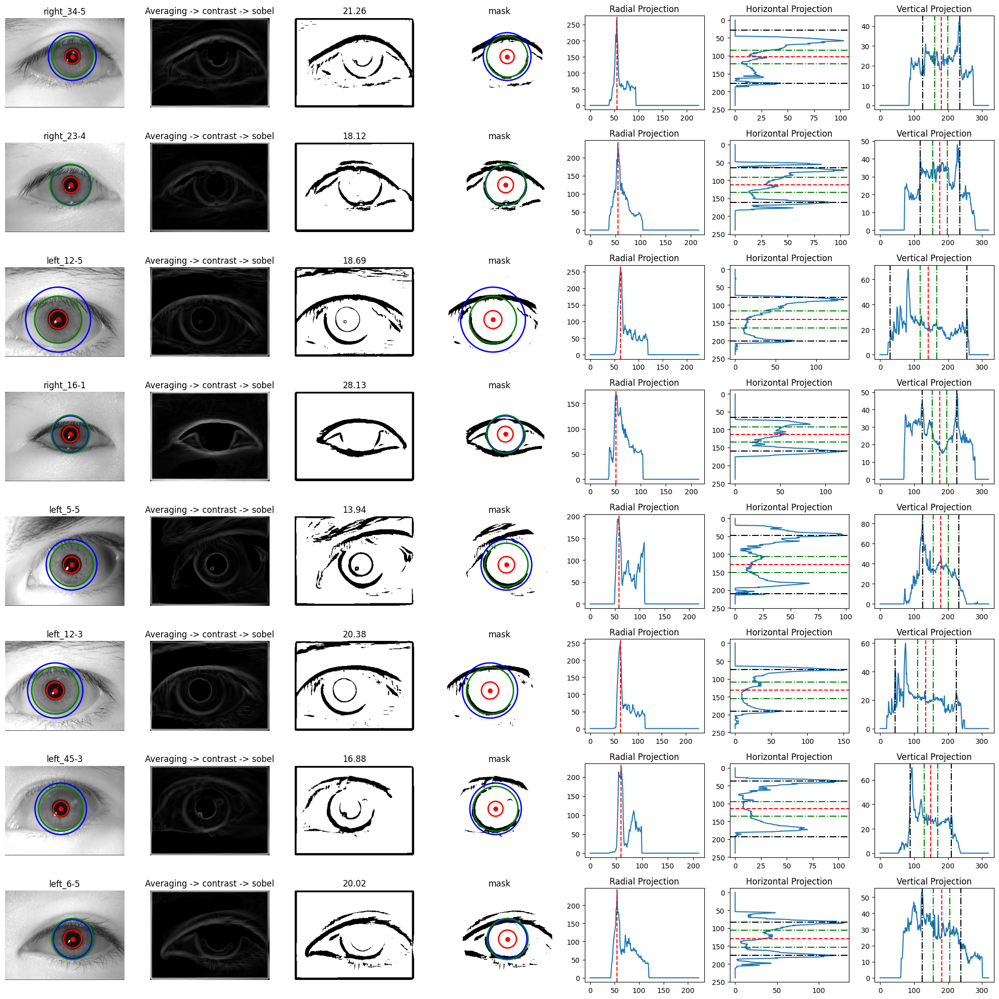

In [19]:
fig, axs = plt.subplots(8, 7, figsize=(20, 20))
axs = axs.ravel()

# for j, k in enumerate(random_idxs):
# for j, k in enumerate([300, 305, 281, 124, 127, 128, 44]):
for j, k in enumerate([278, 158, 34, 77, 404, 32, 383, 414]):
    img = imgs[k, :, :]
    label = labels[k]
    idx = 7 * j

    axs[idx].imshow(img, cmap="gray")
    axs[idx].set_title(label)
    axs[idx].axis("off")

    img = sobel_filter(contrast_filter(averaging_filter(img, kernel_size=11)))
    p = np.mean(img)

    axs[idx + 1].imshow(img, cmap="gray")
    axs[idx + 1].set_title("Averaging -> contrast -> sobel")
    axs[idx + 1].axis("off")

    p = np.mean(img)
    img_bin = img > p / 0.7
    axs[idx + 2].imshow(img_bin, cmap="binary")
    axs[idx + 2].set_title(f"{p:.2f}")
    axs[idx + 2].axis("off")

    (x, y), pupil_radius = pupils[k]
    img_bin = mask_boundary(img_bin, 10)
    img_bin = mask_circle(img_bin, (x, y), 5 * pupil_radius)
    img_bin = mask_circle(img_bin, (x, y), 1.8 * pupil_radius, inside=False)
    img_bin = img_bin & ~pupil_imgs[k, :, :]

    axs[idx + 3].imshow(img_bin, cmap="binary")
    axs[idx + 3].set_title("mask")
    axs[idx + 3].axis("off")

    vertical_projection = np.sum(img_bin, axis=0)
    horizontal_projection = np.sum(img_bin, axis=1)
    radial_projection = get_radial_projection(img_bin, (x, y))

    iris_radus_radial = np.argmax(radial_projection)

    axs[idx + 4].plot(radial_projection)
    axs[idx + 4].set_title("Radial Projection")
    axs[idx + 4].axvline(iris_radus_radial, color="red", linestyle="--", label="Max")

    radius_x = analyse_iris_projection(
        x, pupil_radius=pupil_radius, vector=vertical_projection
    )
    radius_y = analyse_iris_projection(
        y, pupil_radius=pupil_radius, vector=horizontal_projection
    )
    # iris_radius = max(radius_x, radius_y)
    iris_radius = np.ceil((radius_x + radius_y) / 2).astype(int)

    axs[idx + 5].plot(horizontal_projection, range(len(horizontal_projection)))
    axs[idx + 5].axhline(y, color="red", linestyle="--", label="Max")
    axs[idx + 5].axhline(y + pupil_radius, color="green", linestyle="-.")
    axs[idx + 5].axhline(y - pupil_radius, color="green", linestyle="-.")
    axs[idx + 5].axhline(y + radius_y, color="black", linestyle="-.")
    axs[idx + 5].axhline(y - radius_y, color="black", linestyle="-.")
    axs[idx + 5].invert_yaxis()
    axs[idx + 5].set_title("Horizontal Projection")

    axs[idx + 6].plot(vertical_projection)
    axs[idx + 6].axvline(x, color="red", linestyle="--", label="Max")
    axs[idx + 6].axvline(x + pupil_radius, color="green", linestyle="-.")
    axs[idx + 6].axvline(x - pupil_radius, color="green", linestyle="-.")
    axs[idx + 6].axvline(x + radius_x, color="black", linestyle="-.")
    axs[idx + 6].axvline(x - radius_x, color="black", linestyle="-.")
    axs[idx + 6].set_title("Vertical Projection")

    circle_pupil = plt.Circle(
        (x, y), pupil_radius, color="red", fill=False, linewidth=2
    )
    circle_iris = plt.Circle((x, y), iris_radius, color="blue", fill=False, linewidth=2)
    circle_iris_radial = plt.Circle(
        (x, y), iris_radus_radial, color="green", fill=False, linewidth=2
    )
    axs[idx + 3].plot(x, y, "ro")
    axs[idx + 3].add_patch(circle_pupil)
    axs[idx + 3].add_patch(circle_iris)
    axs[idx + 3].add_patch(circle_iris_radial)

    circle_pupil = plt.Circle(
        (x, y), pupil_radius, color="red", fill=False, linewidth=2
    )
    circle_iris = plt.Circle((x, y), iris_radius, color="blue", fill=False, linewidth=2)
    circle_iris_radial = plt.Circle(
        (x, y), iris_radus_radial, color="green", fill=False, linewidth=2
    )
    axs[idx].plot(x, y, "ro")
    axs[idx].add_patch(circle_pupil)
    axs[idx].add_patch(circle_iris)
    axs[idx].add_patch(circle_iris_radial)

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "irises_detection_many.png"),
    dpi=50,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

In [20]:
iris_imgs = transform_iris_imgs(imgs, pupils)

In [21]:
irises = get_irises(iris_imgs, pupils)

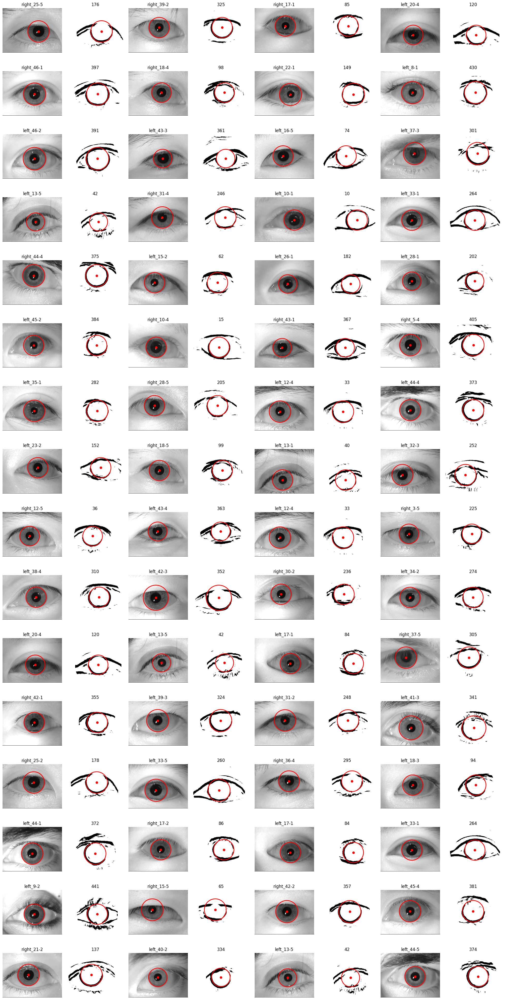

In [22]:
fig, axs = plt.subplots(16, 8, figsize=(20, 40))
axs = axs.ravel()

for j, k in enumerate(np.random.randint(0, imgs.shape[0], 64)):
    img = imgs[k, :, :]
    iris_img = iris_imgs[k, :, :]
    center, iris_radius = irises[k]
    label = labels[k]
    idx = 2 * j

    circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    axs[idx].imshow(img, cmap="gray")
    axs[idx].plot(*center, "ro")
    axs[idx].add_patch(circle)
    axs[idx].set_title(label)
    axs[idx].axis("off")

    circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    axs[idx + 1].imshow(iris_img, cmap="binary")
    axs[idx + 1].plot(*center, "ro")
    axs[idx + 1].add_patch(circle)
    axs[idx + 1].set_title(k)
    axs[idx + 1].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "irises_detected_many.png"),
    dpi=50,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

# Cropping the iris

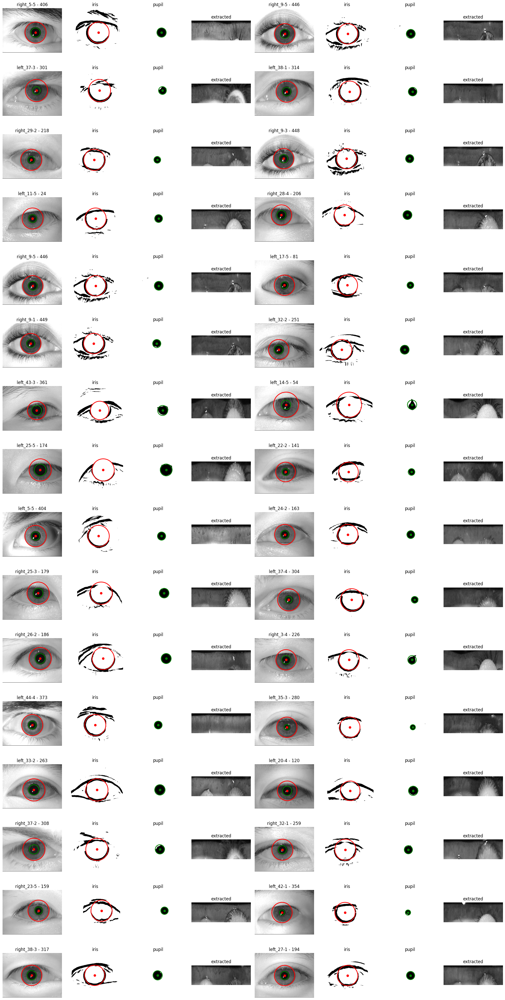

In [23]:
fig, axs = plt.subplots(16, 8, figsize=(20, 40))
axs = axs.ravel()

for j, k in enumerate(np.random.randint(0, imgs.shape[0], 32)):
    img = imgs[k, :, :]
    iris_img = iris_imgs[k, :, :]
    pupil_img = pupil_imgs[k, :, :]
    center, iris_radius = irises[k]
    _, pulipl_radius = pupils[k]
    label = labels[k]
    idx = 4 * j

    iris_circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    pupil_circle = plt.Circle(
        center, pulipl_radius, color="green", fill=False, linewidth=2
    )
    axs[idx].imshow(img, cmap="gray")
    axs[idx].plot(*center, "ro")
    axs[idx].add_patch(iris_circle)
    axs[idx].add_patch(pupil_circle)
    axs[idx].set_title(f"{label} - {k}")
    axs[idx].axis("off")

    circle = plt.Circle(center, iris_radius, color="red", fill=False, linewidth=2)
    axs[idx + 1].imshow(iris_img, cmap="binary")
    axs[idx + 1].plot(*center, "ro")
    axs[idx + 1].add_patch(circle)
    axs[idx + 1].set_title("iris")
    axs[idx + 1].axis("off")

    circle = plt.Circle(center, pulipl_radius, color="green", fill=False, linewidth=2)
    axs[idx + 2].imshow(pupil_img, cmap="binary")
    axs[idx + 2].plot(*center, "go")
    axs[idx + 2].add_patch(circle)
    axs[idx + 2].set_title("pupil")
    axs[idx + 2].axis("off")

    iris_part = unwrap_annular_segment(img, center, pulipl_radius, iris_radius)
    axs[idx + 3].imshow(iris_part, cmap="gray")
    axs[idx + 3].set_title("extracted")
    axs[idx + 3].axis("off")

plt.tight_layout()
plt.savefig(
    os.path.join("figures", "final_comphrasion.png"),
    dpi=50,
    bbox_inches="tight",
    pad_inches=0,
)
plt.show()

In [24]:
irises_parts = get_irises_parts(imgs_original, pupils, irises)

In [25]:
irises_parts.shape

(450, 50, 150, 3)

# Saving Results

In [ ]:
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    save_imgs(imgs, iris_imgs, pupil_imgs, irises_parts, irises, pupils, labels)

# Daugman's Algorithm

In [27]:
base_dirs = {
        "images": "data/images",
        "extracted_irises": "data/extracted_irises",
        "irises": "data/irises",
        "pupils": "data/pupils",
    }

extracted_irises_dir = base_dirs["extracted_irises"]

## Sample image loaded

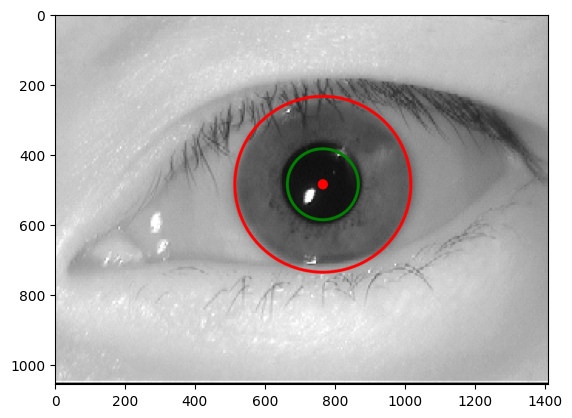

In [28]:
original_image = imread("data/images/left/38-1.png")
plt.imshow(original_image, cmap="gray")

(470, 1410)

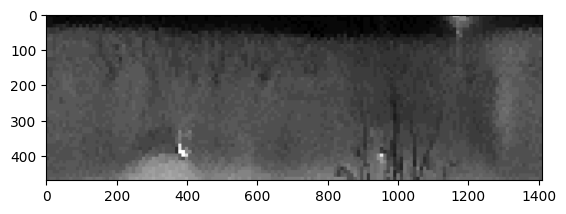

In [29]:
sample_image = imread("data/extracted_irises/left/38-1.png")[:, :, 0]
plt.imshow(sample_image, cmap="gray")
sample_image.shape

(440, 1410)

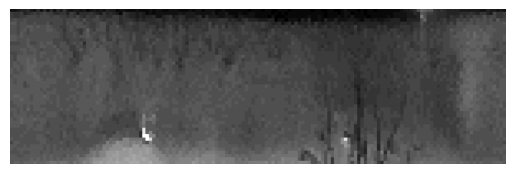

In [30]:
rows_to_remove = sample_image.shape[0] - 440 # so that it is divisible by 8 (like the 8 bands we use)
cropped_image = sample_image[rows_to_remove:, :]

plt.imshow(cropped_image, cmap="gray")
plt.axis("off")

cropped_image.shape

Frequency has a major effects both on the resulting code as well as the distance difference between different people

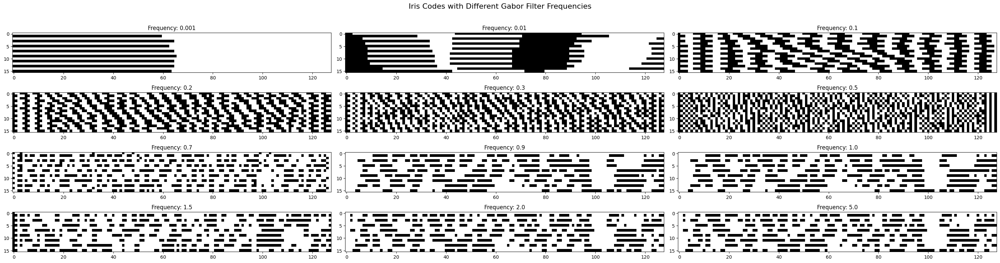

In [31]:
frequencies = [0.001, 0.01, 0.1, 0.2, 0.3, 0.5, 0.7, 0.9, 1.0, 1.5, 2.0, 5.0]

fig, axes = plt.subplots(4, 3, figsize=(30, 8))
axes = axes.flatten()

for i, freq in enumerate(frequencies):
    iris_code = image_to_iris_code(sample_image, gabor_frequency=freq)
    ax = axes[i]
    im = ax.imshow(iris_code, cmap="gray")
    ax.set_title(f"Frequency: {freq}")

plt.tight_layout()
fig.suptitle("Iris Codes with Different Gabor Filter Frequencies", fontsize=16)
plt.subplots_adjust(top=0.9) 

plt.show()

## Effect on seperation between people

In [32]:
iris_grouped = {}
filenames = []

for filename in os.listdir(extracted_irises_dir+"/left"):
    name_split = filename.replace(".png", "").split("-")
    iris_id = name_split[0]
    if iris_grouped.get(iris_id) is None:
        iris_grouped[iris_id] = []
    if filename.endswith(".png"):
        iris_grouped[iris_id].append(filename)
        filenames.append(filename)

print(iris_grouped)
print(f"Number of iris groups: {len(iris_grouped)}")

{'28': ['28-3.png', '28-2.png', '28-1.png', '28-5.png', '28-4.png'], '13': ['13-5.png', '13-4.png', '13-3.png', '13-2.png', '13-1.png'], '37': ['37-4.png', '37-5.png', '37-2.png', '37-3.png', '37-1.png'], '17': ['17-1.png', '17-2.png', '17-3.png', '17-4.png', '17-5.png'], '31': ['31-2.png', '31-3.png', '31-1.png', '31-4.png', '31-5.png'], '9': ['9-1.png', '9-2.png', '9-3.png', '9-4.png', '9-5.png'], '15': ['15-3.png', '15-2.png', '15-1.png', '15-5.png', '15-4.png'], '33': ['33-1.png', '33-3.png', '33-2.png', '33-5.png', '33-4.png'], '35': ['35-5.png', '35-4.png', '35-1.png', '35-3.png', '35-2.png'], '11': ['11-4.png', '11-5.png', '11-1.png', '11-2.png', '11-3.png'], '8': ['8-2.png', '8-3.png', '8-1.png', '8-4.png', '8-5.png'], '32': ['32-3.png', '32-2.png', '32-1.png', '32-5.png', '32-4.png'], '30': ['30-1.png', '30-2.png', '30-3.png', '30-4.png', '30-5.png'], '16': ['16-2.png', '16-3.png', '16-1.png', '16-4.png', '16-5.png'], '10': ['10-4.png', '10-5.png', '10-2.png', '10-3.png', '10-

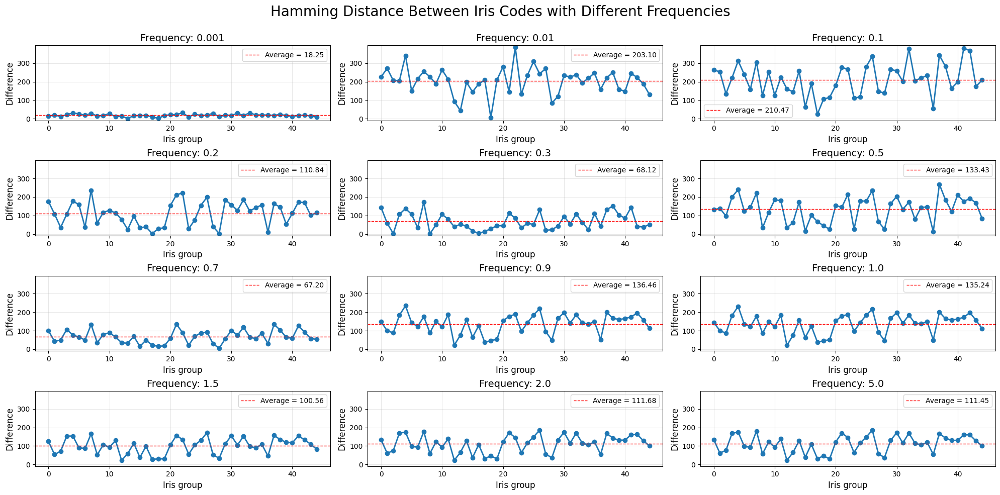

In [33]:
fig, axes = plt.subplots(4, 3, figsize=(20, 10))
axes = axes.flatten()

all_differences = []

for i, freq in enumerate(frequencies):
    iris_codes = {}
    gabor_frequency = freq
    for filename in filenames:
        iris_code = image_to_iris_code(imread(os.path.join(extracted_irises_dir, "left", filename))[:, :, 0], 
                                         gabor_frequency=gabor_frequency)
        iris_codes[filename] = iris_code
    
    differences = []
    for key in iris_grouped.keys():
        same_group = []
        differnet_group = []
        for key2 in iris_grouped.keys():
            if key != key2:
                differnet_group += iris_grouped[key2]
            else:
                same_group += iris_grouped[key2]
        
        reference_code = iris_codes[same_group[0]]
        same_group.pop(0)
        
        average_distance_in_group = 0
        for element in same_group:
            hd = int((reference_code != iris_codes[element]).sum())
            average_distance_in_group += hd
        average_distance_in_group /= len(same_group) if same_group else 1
        
        average_distance_in_different_group = 0
        sample_different = differnet_group
        group_len = 0
        for element in sample_different:
            hd = int((reference_code != iris_codes[element]).sum())
            average_distance_in_different_group += hd
            group_len += 1
        if group_len > 0:
            average_distance_in_different_group /= group_len
        differences.append(abs(average_distance_in_different_group - average_distance_in_group))
    
    all_differences.extend(differences)
    
    ax = axes[i]
    ax.plot(differences, marker='o', linewidth=2)
    ax.set_title(f"Frequency: {freq}", fontsize=14)
    
    avg = np.mean(differences)
    ax.axhline(y=avg, color='red', linestyle='--', linewidth=1, 
               label=f'Average = {avg:.2f}')
    
    ax.set_xlabel("Iris group", fontsize=12)
    ax.set_ylabel("Difference", fontsize=12)
    ax.legend(fontsize=10)
    ax.grid(True, alpha=0.3)

y_min = min(all_differences) - 10
y_max = max(all_differences) + 10
for ax in axes:
    ax.set_ylim(y_min, y_max)

plt.tight_layout()
fig.suptitle("Hamming Distance Between Iris Codes with Different Frequencies", fontsize=20)
plt.subplots_adjust(top=0.9)
plt.show()

Based on the test, the best frequency is 0.5, so that's the frequency we'll use from now on

In [34]:
best_gabor_frequency = 0.1

## Daughman demo

### Helpers

In [35]:
def compare_codes(iris_code1, iris_code2):
    """
    Compare two iris codes and return the Hamming distance.
    """
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    axes[0].imshow(iris_code1, cmap="gray")
    axes[0].set_title("Iris Code 1")
    
    axes[1].imshow(iris_code2, cmap="gray")
    axes[1].set_title("Iris Code 2")

    axes[2].imshow(iris_code1 != iris_code2, cmap="gray")
    axes[2].set_title("Difference")

    hamming_distance = int((iris_code1 != iris_code2).sum())
    print(f"Hamming distance: {hamming_distance}. Total bits: {iris_code1.size}. Percentage: {hamming_distance / iris_code1.size:.2%}") 
    return hamming_distance


### Same person different eyes

Hamming distance: 913. Total bits: 2048. Percentage: 44.58%


913

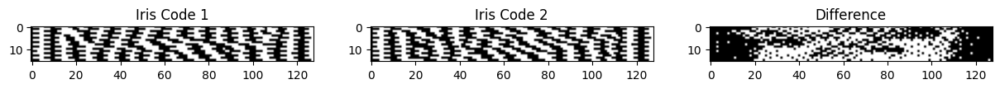

In [36]:
person_1 = iris_grouped["44"]
first_image = person_1[0]
second_image = person_1[0]

first_image_code = image_to_iris_code(imread(os.path.join(extracted_irises_dir, "left", first_image))[:, :, 0], gabor_frequency=best_gabor_frequency)
second_image_code = image_to_iris_code(imread(os.path.join(extracted_irises_dir, "right", second_image))[:, :, 0], gabor_frequency=best_gabor_frequency)

compare_codes(first_image_code, second_image_code)

### Same person same eye

Hamming distance: 560. Total bits: 2048. Percentage: 27.34%


560

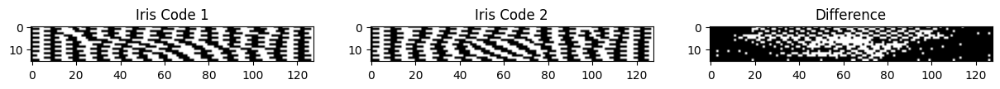

In [37]:
person_1 = iris_grouped["44"]
first_image = person_1[1]
second_image = person_1[2]

first_image_code = image_to_iris_code(imread(os.path.join(extracted_irises_dir, "left", first_image))[:, :, 0], gabor_frequency=best_gabor_frequency)
second_image_code = image_to_iris_code(imread(os.path.join(extracted_irises_dir, "left", second_image))[:, :, 0], gabor_frequency=best_gabor_frequency)

compare_codes(first_image_code, second_image_code)

### Different people

Hamming distance: 877. Total bits: 2048. Percentage: 42.82%


877

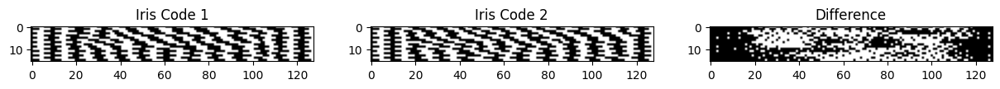

In [38]:
first_image = iris_grouped["14"][0]
second_image = iris_grouped["25"][0]

first_image_code = image_to_iris_code(imread(os.path.join(extracted_irises_dir, "left", first_image))[:, :, 0], gabor_frequency=best_gabor_frequency)
second_image_code = image_to_iris_code(imread(os.path.join(extracted_irises_dir, "left", second_image))[:, :, 0], gabor_frequency=best_gabor_frequency)

compare_codes(first_image_code, second_image_code)

### Entire process demonstrated

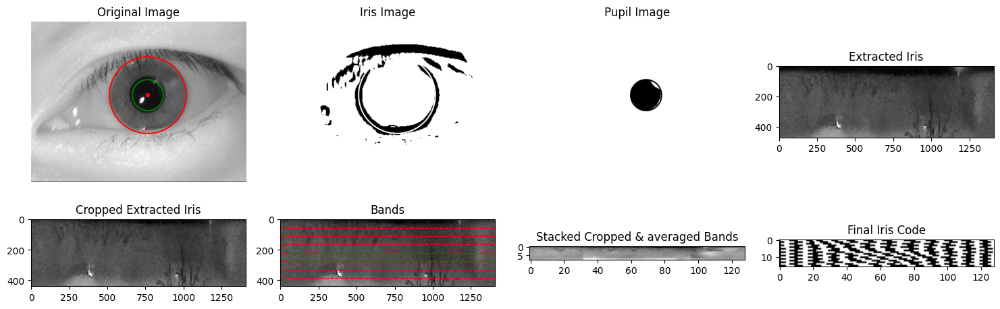

In [53]:
original_image = imread(os.path.join(base_dirs['images'], "left", "38-1.png"))
iris_image = imread(os.path.join(base_dirs['irises'], "left", "38-1.png"))[:, :, 0]
pupil_image = imread(os.path.join(base_dirs["pupils"], "left", "38-1.png"))[:, :, 0]

sample_image_path = os.path.join(base_dirs["extracted_irises"], "left", "38-1.png")

extracted_iris = imread(sample_image_path)[:, :, 0]

rows_to_remove = extracted_iris.shape[0] - 440
cropped_extracted_iris = extracted_iris[rows_to_remove:, :]

bands = np.zeros((extracted_iris.shape[0], extracted_iris.shape[1], 8), dtype=np.uint8)

stacked_cropped_bands = np.vstack(get_cropped_bands_rescaled(
    cropped_image,
    plot=False,
    number_of_bands=8,
    plot_iris_code=False,
    gabor_frequency=0.25,
))

final_code = image_to_iris_code(imread(sample_image_path)[:, :, 0], gabor_frequency=best_gabor_frequency)


fig, axes = plt.subplots(2, 4, figsize=(15, 10))

axes[0, 0].imshow(original_image, cmap="gray")
axes[0, 0].set_title("Original Image")
axes[0, 0].axis("off")

axes[0, 1].imshow(iris_image, cmap="gray")  
axes[0, 1].set_title("Iris Image")
axes[0, 1].axis("off")

axes[0, 2].imshow(pupil_image, cmap="gray")
axes[0, 2].set_title("Pupil Image")
axes[0, 2].axis("off")

axes[0, 3].imshow(extracted_iris, cmap="gray")
axes[0, 3].set_title("Extracted Iris")

axes[1, 0].imshow(cropped_extracted_iris, cmap="gray")
axes[1, 0].set_title("Cropped Extracted Iris")

axes[1, 1].imshow(cropped_extracted_iris, cmap="gray")
axes[1, 1].set_title("Bands")

ax_band = axes[1, 1]
ax_band.imshow(cropped_extracted_iris, cmap="gray")
ax_band.set_title("Bands")
total_rows = cropped_extracted_iris.shape[0]
band_height = total_rows / 8

for i in range(1, 8):
    y = i * band_height
    ax_band.axhline(y=y, color="red", linestyle="--", linewidth=1)

axes[1, 2].imshow(stacked_cropped_bands, cmap="gray")
axes[1, 2].set_title("Stacked Cropped & averaged Bands")

axes[1, 3].imshow(final_code, cmap="gray")
axes[1, 3].set_title("Final Iris Code")

plt.tight_layout()
plt.subplots_adjust(hspace=-0.7)
plt.show()


### Performance tests

In [51]:
# Perform the operation 100 times and calculate mean and std
read_times = []
code_times = []

for _ in range(100):
    # Measure the time to read the image
    start_time = time.perf_counter()
    image_read = imread(sample_image_path)[:, :, 0]
    read_times.append(time.perf_counter() - start_time)

    # Measure the time to generate the iris code
    start_time = time.perf_counter()
    final_code = image_to_iris_code(image_read, gabor_frequency=best_gabor_frequency)
    code_times.append(time.perf_counter() - start_time)

# Calculate mean and standard deviation
read_mean = np.mean(read_times)
read_std = np.std(read_times)
code_mean = np.mean(code_times)
code_std = np.std(code_times)
total_mean = read_mean + code_mean
total_std = np.std(read_times + code_times)

print(f"Image read time: Mean = {read_mean:.4f} seconds, Std = {read_std:.4f} seconds")
print(f"Image to code time: Mean = {code_mean:.4f} seconds ({1/code_mean:.2f} codes per second), Std = {code_std:.4f} seconds")
print(f"Total interface time: Mean = {total_mean:.4f} seconds ({1/total_mean:.2f} codes per second), Std = {total_std:.4f} seconds")


Image read time: Mean = 0.0027 seconds, Std = 0.0020 seconds
Image to code time: Mean = 0.0012 seconds (810.63 codes per second), Std = 0.0032 seconds
Total interface time: Mean = 0.0039 seconds (253.33 codes per second), Std = 0.0028 seconds
